# **Detectron2 con dos modelos entrenadores**

## Realizado por Ismael Franco Hernando

La instalación, configuración y uso de Detectron2 de este Notebook se ha basado en el tutorial que la prorpia libreria tiene: https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5

### Instalar librerias

In [1]:
!pip install pyyaml==5.1

     |████████████████████████████████| 274 kB 5.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=838a28fd6f09a2110371b06a56d8d40cb7965a1589e54d6582e8fb1c43a11eee
  Stored in directory: /root/.cache/pip/wheels/77/f5/10/d00a2bd30928b972790053b5de0c703ca87324f3fead0f2fd9
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [2]:
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu111/torch1.10/index.html
     |████████████████████████████████| 7.0 MB 1.1 MB/s 
     |████████████████████████████████| 130 kB 5.0 MB/s 
     |████████████████████████████████| 50 kB 4.8 MB/s 
     |████████████████████████████████| 74 kB 2.2 MB/s 
     |████████████████████████████████| 147 kB 11.0 MB/s 
     |████████████████████████████████| 843 kB 44.4 MB/s 
     |████████████████████████████████| 749 kB 38.1 MB/s 
     |████████████████████████████████| 112 kB 49.7 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220414-py3-none-any.whl size=61211 sha256=47bc4baccf40f98d5c1077a15734bab87f782bc48fccacb4a36421473dd2fc35
  Stored in directory: /root/.cache/pip/wheels/df/f4/b8/7b5df8b6722f4c72315ce70c31aa693e00cef6a5056149bd28
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=7b423ab2326e84ce532caa849e528610e0cf74f03bd42af18a6b85c881e971

### Imports

In [3]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Librerias de uso común
import numpy as np
import shutil
import os
import json
import cv2
import random
from google.colab.patches import cv2_imshow

# Utilidades del detectron2
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode
from detectron2 import structures
from detectron2.structures.boxes import Boxes


## Distrubución de los datos de forma aleatoria


In [4]:
def crea_directorio(directorio):
    if not os.path.isdir(directorio):
        os.makedirs(directorio, exist_ok=True)


In [5]:
def mueve_imagenes(directorio_salida, lista):
    crea_directorio(directorio_salida)

    for l in lista:
        ruta = l.split("/")
        imagen = ruta[1].split(".")
        json = imagen[0] + '_1.json'

        shutil.move(l, directorio_salida+ruta[1])
        shutil.move(ruta[0]+'/'+json, directorio_salida+json)


In [6]:
def distribuye_imagenes(origen, dir_train, dir_test, dir_val,
                        porcentajes=[0.6, 0.2, 0.2]):
    lista = []
    for fichero in os.listdir(origen):
        if fichero.endswith('.png'):
            lista.append(origen+fichero)

    totales = len(lista)
    lista_random = np.random.choice(lista, totales, False)

    lista_train = []
    lista_test = []
    lista_val = []
    tam_train = porcentajes[0] * totales
    tam_val = porcentajes[1] * totales
    tam_test = porcentajes[2] * totales

    for ele in lista_random:
        if len(lista_test) < tam_test-1 or len(lista_test) == tam_test-1:
            lista_test.append(ele)
        elif len(lista_val) < tam_val-1 or len(lista_val) == tam_test-1:
            lista_val.append(ele)
        else:
            lista_train.append(ele)

    mueve_imagenes(dir_train, lista_train)
    mueve_imagenes(dir_test, lista_test)
    mueve_imagenes(dir_val, lista_val)

    print("Hay un total de " + str(totales) + " imagenes")
    print(str(len(lista_train)) + " son para entrenamiento")
    print(str(len(lista_test)) + " son para test")
    print(str(len(lista_val)) + " son para validación")


In [7]:
def mueve_nervios(origen, destino):
    crea_directorio(destino)
    lista = []
    for fichero in os.listdir(origen):
        if fichero.endswith('_2.json'):
            lista.append(origen + fichero)

    for l in lista:
        ruta = l.split('/')
        shutil.move(l, destino+ruta[1])


In [8]:
mueve_nervios('todos/', 'nervios/')


In [9]:
distribuye_imagenes('todos/', 'dientes_train/', 'dientes_test/',
                    'dientes_val/')


Hay un total de 30 imagenes
18 son para entrenamiento
6 son para test
6 son para validación


## Función que transforma los archivos json al estándar COCO

In [ ]:
def conversor_COCO(directorio):
    # Leemos todos los archivos del directorio y guardamos el nombre
    # de los .json
    ficheros_JSON = []
    for fichero in os.listdir(directorio):
        if fichero.endswith('.json'):
            ficheros_JSON.append(fichero)

    dataset = []

    # Recorremos cada fichero
    for fichero in ficheros_JSON:
        # Cargamos la ruta de cada fichero
        f_json = os.path.join(directorio, fichero)
        # Cargamos el fichero
        with open(f_json) as f:
            json_cargado = json.load(f)

        diccionario = {}
        key_fichero = list(json_cargado.keys())[0]

        ruta_imagen = os.path.join(directorio, fichero[:-7]+".png")
        altura = cv2.imread(ruta_imagen).shape[0]
        anchura = cv2.imread(ruta_imagen).shape[1]

        diccionario["file_name"] = ruta_imagen
        diccionario["height"] = altura
        diccionario["width"] = anchura

        valores = []
        regiones = json_cargado[key_fichero]['regions']

        for i in range(len(regiones)):
            puntos_x = regiones[i]['shape_attributes']['all_points_x']
            puntos_y = regiones[i]['shape_attributes']['all_points_y']
            forma = [(x, y) for x, y in zip(puntos_x, puntos_y)]
            forma = [p for x in forma for p in x]

            valor = {"bbox": [np.min(puntos_x), np.min(puntos_y),
                     np.max(puntos_x), np.max(puntos_y)],
                     "bbox_mode": BoxMode.XYXY_ABS,
                     "segmentation": [forma],
                     "category_id": 0}

            valores.append(valor)
        diccionario["annotations"] = valores
        dataset.append(diccionario)
    return dataset
  

# Entrenamos el Diente

In [ ]:
clases = ['diente']

for d in ["train", "test", "val"]:
    DatasetCatalog.register("dientes_" + d,
                            lambda d=d: conversor_COCO("dientes_"+d+"/"))
    MetadataCatalog.get("dientes_" + d).set(thing_classes=clases)


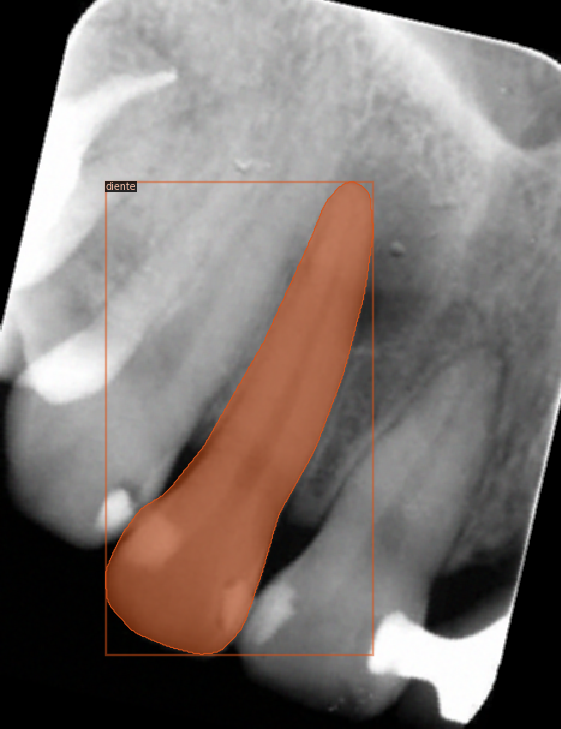

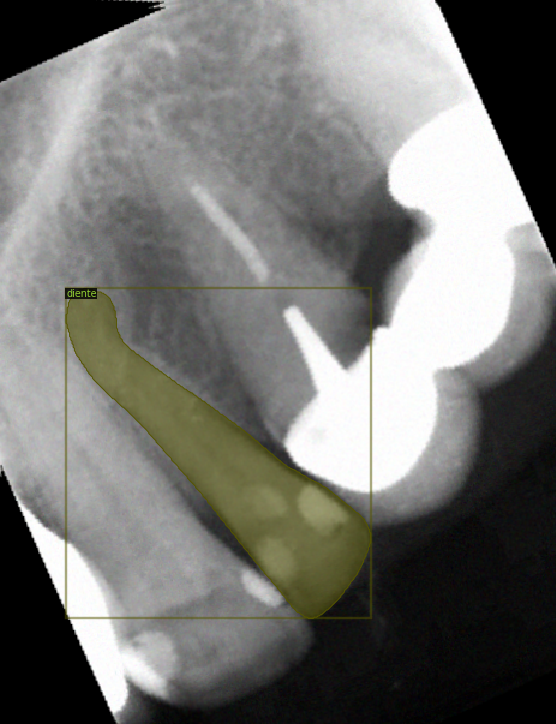

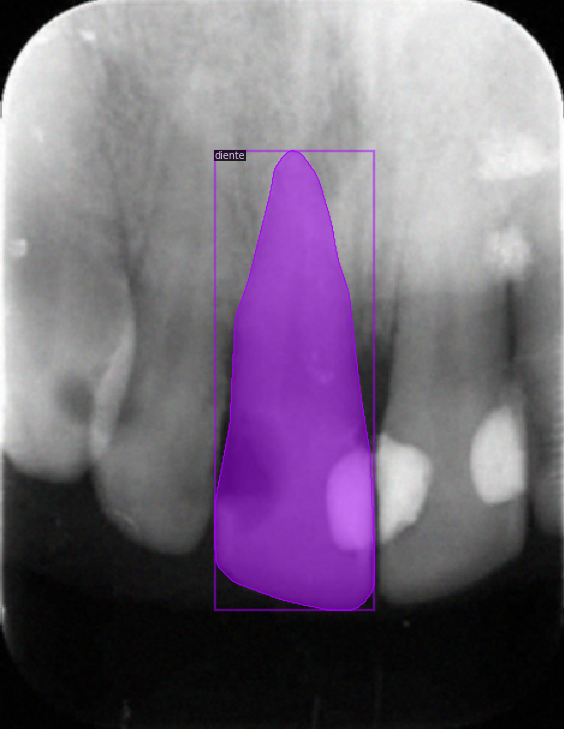

In [ ]:
dientes_metadata = MetadataCatalog.get("dientes_train")
dataset_train_di = conversor_COCO("dientes_train/")

for d in random.sample(dataset_train_di, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1],
                            metadata=dientes_metadata,
                            scale=1.2)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dientes_train",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 2000
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.TEST.DTECTIONS_PER_IMAGE = 1


In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()


[04/21 19:18:30 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:03, 48.0MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to i

[04/21 19:18:40 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[04/21 19:19:07 d2.utils.events]:  eta: 0:43:56  iter: 19  total_loss: 1.411  loss_cls: 0.5851  loss_box_reg: 0.1024  loss_mask: 0.694  loss_rpn_cls: 0.01379  loss_rpn_loc: 0.01659  time: 1.3331  data_time: 0.0206  lr: 4.9953e-06  max_mem: 2338M
[04/21 19:19:34 d2.utils.events]:  eta: 0:44:24  iter: 39  total_loss: 1.298  loss_cls: 0.4883  loss_box_reg: 0.09504  loss_mask: 0.6906  loss_rpn_cls: 0.01436  loss_rpn_loc: 0.01455  time: 1.3412  data_time: 0.0091  lr: 9.9902e-06  max_mem: 2338M
[04/21 19:20:00 d2.utils.events]:  eta: 0:43:42  iter: 59  total_loss: 1.16  loss_cls: 0.3408  loss_box_reg: 0.1049  loss_mask: 0.6848  loss_rpn_cls: 0.01883  loss_rpn_loc: 0.01702  time: 1.3340  data_time: 0.0089  lr: 1.4985e-05  max_mem: 2338M
[04/21 19:20:28 d2.utils.events]:  eta: 0:43:30  iter: 79  total_loss: 1.043  loss_cls: 0.2355  loss_box_reg: 0.1027  loss_mask: 0.676  loss_rpn_cls: 0.01207  loss_rpn_loc: 0.01373  time: 1.3427  data_time: 0.0107  lr: 1.998e-05  max_mem: 2338M
[04/21 19:20:55

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.75
predictor = DefaultPredictor(cfg)


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


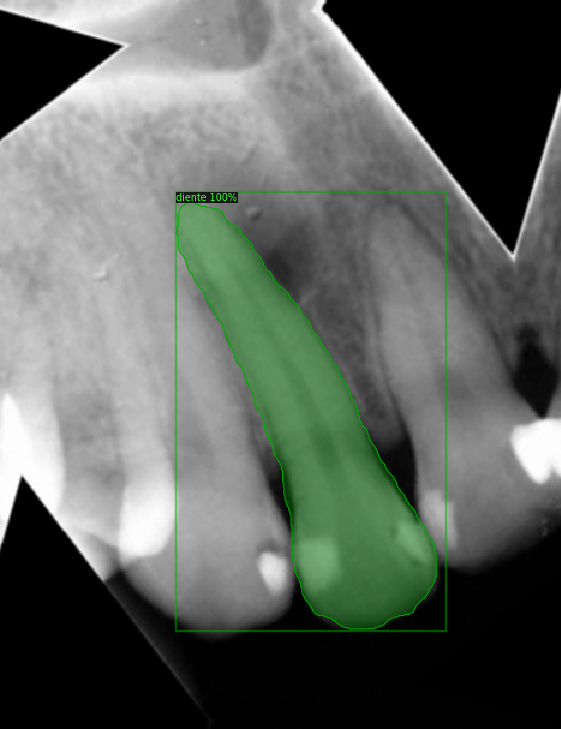

La precisión obtenida en el diente es [[0.9437687]]


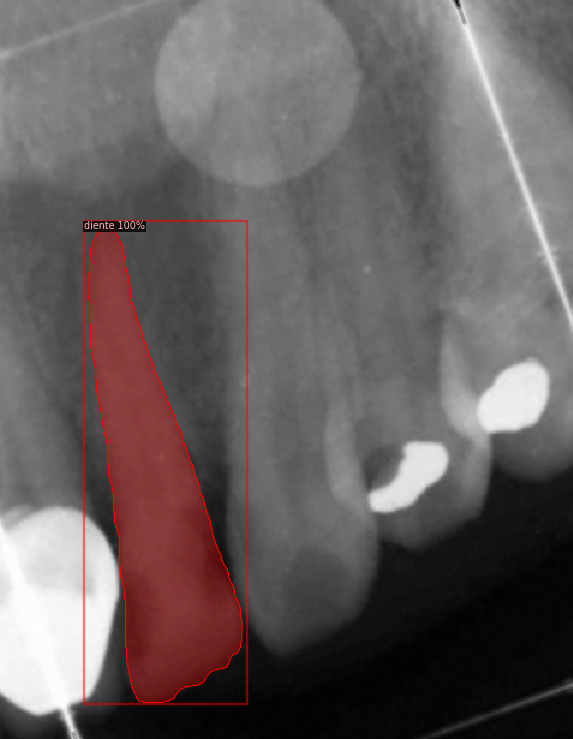

La precisión obtenida en el diente es [[0.9463418]]


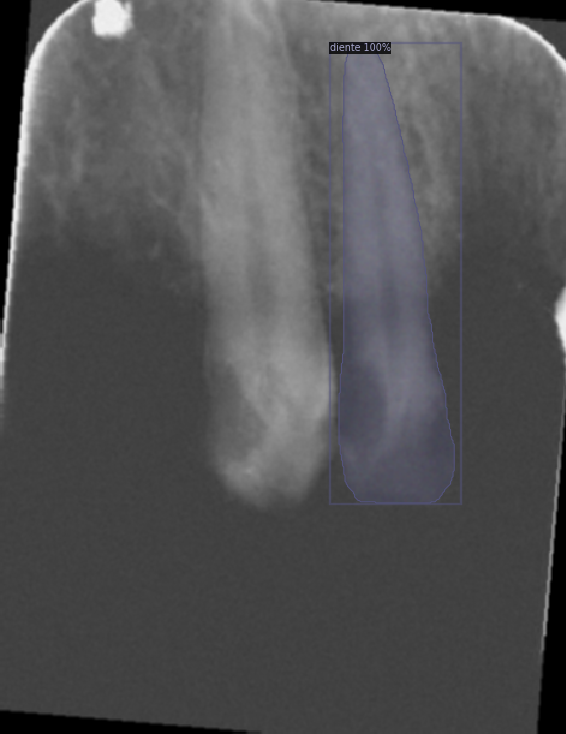

La precisión obtenida en el diente es [[0.8594462]]


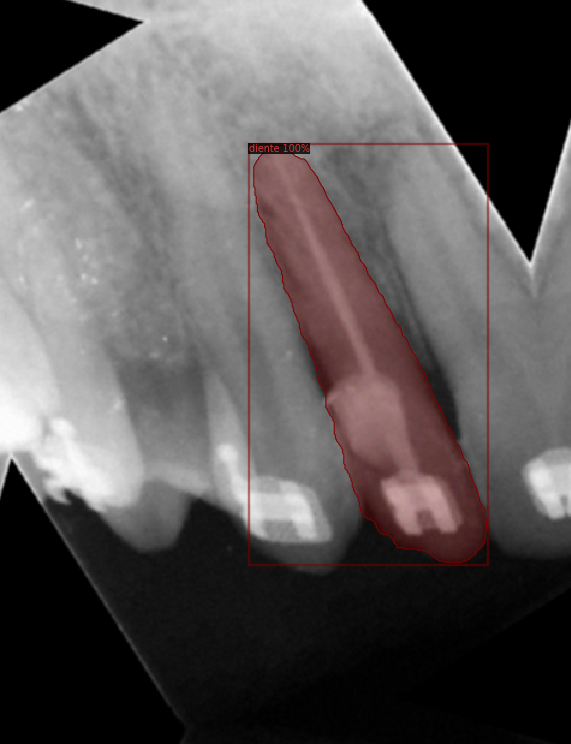

La precisión obtenida en el diente es [[0.96366626]]


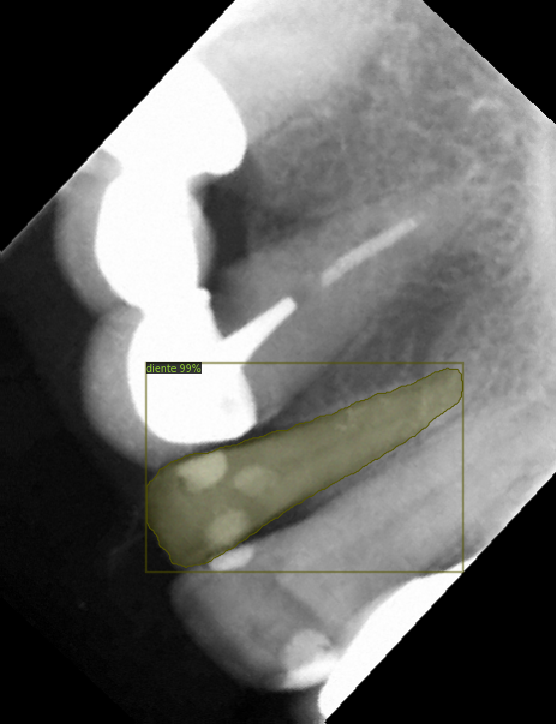

La precisión obtenida en el diente es [[0.84264153]]


La precision media obtenida en los dientes es de: 0.91117287


In [ ]:
dataset_test_di = conversor_COCO("dientes_test/")
iou_dientes = []

for d in dataset_test_di:
    im = cv2.imread(d["file_name"])
    puntos=d["annotations"][0]["bbox"]

    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=dientes_metadata,
                   scale=1.2,
                   instance_mode=ColorMode.IMAGE_BW)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

    #Calculo Intersection over Union (IoU)
    predicciones = outputs["instances"].pred_boxes #Obtenemos las predicciones  
    torch_array = torch.tensor([(puntos)]).to("cpu") #Creamos el array de torch con los puntos correctos del elemento  
    caja = Boxes(torch_array) #Creamos la caja de los puntos correctos

    if len(predicciones)==0:
      print("No se han encontrado ningún diente")
    else:    
      iou = structures.pairwise_iou(predicciones[0].to("cpu"),caja)
      iou = iou.to("cpu").numpy()
      iou_dientes.append(iou)
      print("La precisión obtenida en el diente es",iou)

iou_dientes = np.array(iou_dientes)
print("\n\nLa precision media obtenida en los dientes es de:", iou_dientes.mean())

## Validación 

In [ ]:
# Para realizar la tarea de validación, Detectron2 no incluye ninguna
# herramienta directa que permita realizarla, por tanto, he decidido usar
# la respuesta de un usuario en uno de los issues de Detectron2 en GitHub,
# que podemos encontrarla en el siguiente enlace:
# https://github.com/facebookresearch/detectron2/issues/810#issuecomment-698523690

from detectron2.engine import HookBase
from detectron2.data import build_detection_train_loader
import detectron2.utils.comm as comm

cfg.DATASETS.VAL = ("dientes_val",)
cfg.SOLVER.MAX_ITER = 4000

class ValidationLoss(HookBase):
    def __init__(self, cfg):
        super().__init__()
        self.cfg = cfg.clone()
        self.cfg.DATASETS.TRAIN = cfg.DATASETS.VAL
        self._loader = iter(build_detection_train_loader(self.cfg))
        
    def after_step(self):
        data = next(self._loader)
        with torch.no_grad():
            loss_dict = self.trainer.model(data)
            
            losses = sum(loss_dict.values())
            assert torch.isfinite(losses).all(), loss_dict

            loss_dict_reduced = {"val_" + k: v.item() for k, v in 
                                 comm.reduce_dict(loss_dict).items()}
            losses_reduced = sum(loss for loss in loss_dict_reduced.values())
            if comm.is_main_process():
                self.trainer.storage.put_scalars(total_val_loss=losses_reduced, **loss_dict_reduced)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
val_loss = ValidationLoss(cfg)  
trainer.register_hooks([val_loss])
# swap the order of PeriodicWriter and ValidationLoss
trainer._hooks = trainer._hooks[:-2] + trainer._hooks[-2:][::-1]
trainer.resume_or_load(resume=False)
trainer.train()


In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Recortamos el Diente

In [ ]:
def recorta_dientes(dataset_dicts, directorio_salida,
                    directorio_json, mostrar=False):
    if not os.path.isdir(directorio_salida):
        os.makedirs(directorio_salida, exist_ok=True)

    for dic in dataset_dicts:
        nombre_foto = dic["file_name"]
        nombre = nombre_foto.split("/")
        img = cv2.imread(nombre_foto)
        caja = dic["annotations"][0]["bbox"]

        recorta_imagen(img, caja, nombre[1], directorio_salida, mostrar)
        actualiza_JSON(directorio_json, directorio_salida,
                       nombre[1][:-4]+'_2.json', caja[0], caja[1])


In [ ]:
def recorta_dientes_test(dataset_dicts, directorio_salida,
                         directorio_json, mostrar=False):
    if not os.path.isdir(directorio_salida):
        os.makedirs(directorio_salida, exist_ok=True)

    for dic in dataset_dicts:
        nombre_foto = dic["file_name"]
        nombre = nombre_foto.split("/")
        img = cv2.imread(nombre_foto)
        outputs = predictor(img)
        predicciones = outputs["instances"].pred_boxes.to("cpu")
        caja = predicciones.tensor.tolist()[0]

        recorta_imagen(img, caja, nombre[1], directorio_salida, mostrar)
        actualiza_JSON(directorio_json, directorio_salida,
                       nombre[1][:-4]+'_2.json', int(round(caja[0])),
                       int(round(caja[1])))


In [ ]:
def recorta_imagen(img, caja, nombre_foto, directorio, mostrar=False):
    recorte = img[int(round(caja[1])):int(round(caja[3])),
                  int(round(caja[0])):int(round(caja[2]))]
    if mostrar:
        cv2_imshow(recorte)
    cv2.imwrite(directorio+nombre_foto, recorte)

In [ ]:
def actualiza_JSON(directorio_json, directorio_salida, nombre, origen_x,
                   origen_y):
    # Cargamos la ruta del fichero
    f_json = os.path.join(directorio_json, nombre)

    # Cargamos el fichero
    with open(f_json) as f:
        json_cargado = json.load(f)
        # Obtenemos la clave del fichero
        key_fichero = list(json_cargado.keys())[0]
        # Guardamos la ruta de donde estan los putnos
        ruta_puntos = json_cargado[key_fichero]["regions"][0]["shape_attributes"]

        # Actualizamos los puntos con el nuevo origne
        puntos_x = np.array(ruta_puntos["all_points_x"])
        puntos_x = puntos_x-origen_x
        puntos_y = np.array(ruta_puntos["all_points_y"])
        puntos_y = puntos_y-origen_y

        # Guaradmos los puntos actualizados
        ruta_puntos["all_points_x"] = puntos_x.tolist()
        ruta_puntos["all_points_y"] = puntos_y.tolist()

        # Guardamos el nuevo json
        with open(directorio_salida+nombre, 'w') as fichero:
            json.dump(json_cargado, fichero)


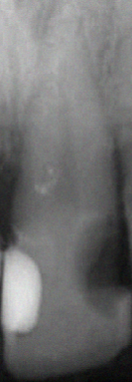

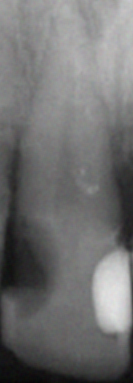

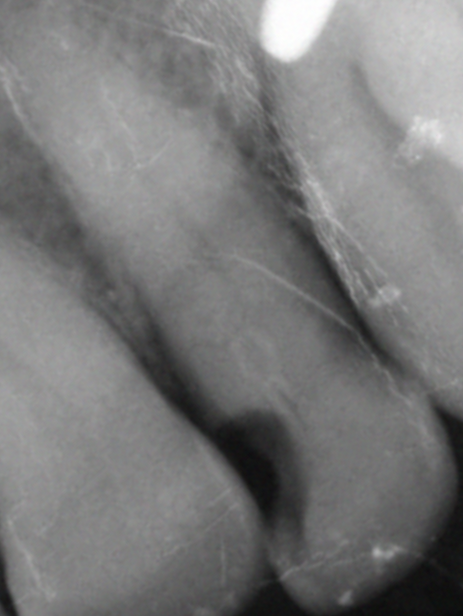

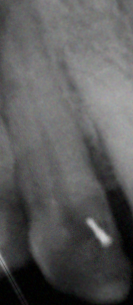

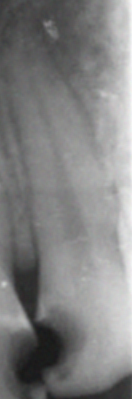

...

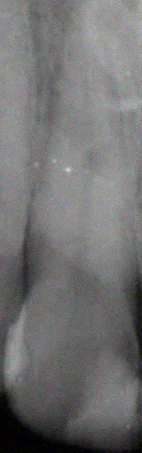

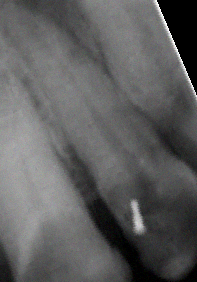

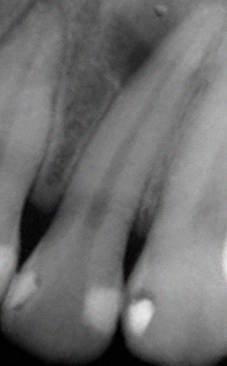

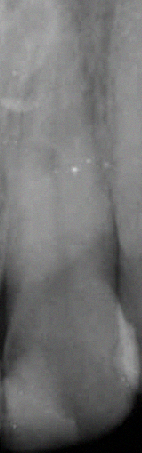

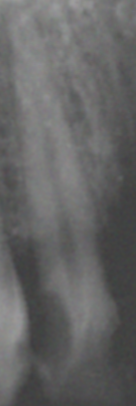

In [ ]:
recorta_dientes(dataset_train_di, 'nervios_train/', 'nervios/', mostrar=True)


In [ ]:
dataset_val_di = conversor_COCO("dientes_val/")
recorta_dientes(dataset_val_di, 'nervios_val/', 'nervios/', mostrar=True)


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


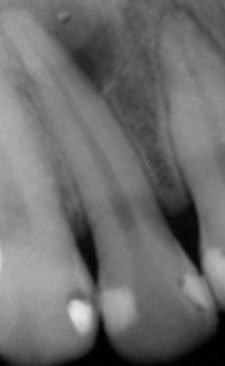

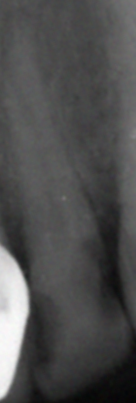

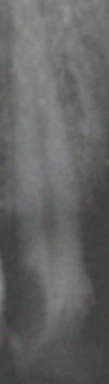

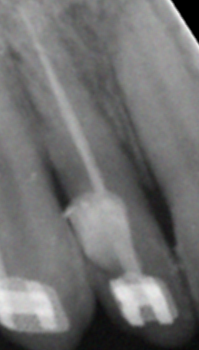

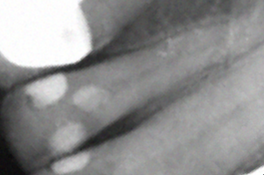

In [ ]:
recorta_dientes_test(dataset_test_di, 'nervios_test/', 'nervios/', mostrar=True)


#Entrenamos el Nervio

In [ ]:
clases = ['nervio']

for d in ["train", "test", "val"]:
    DatasetCatalog.register("nervios_" + d,
                            lambda d=d: conversor_COCO("nervios_"+d+"/"))
    MetadataCatalog.get("nervios_" + d).set(thing_classes=clases)


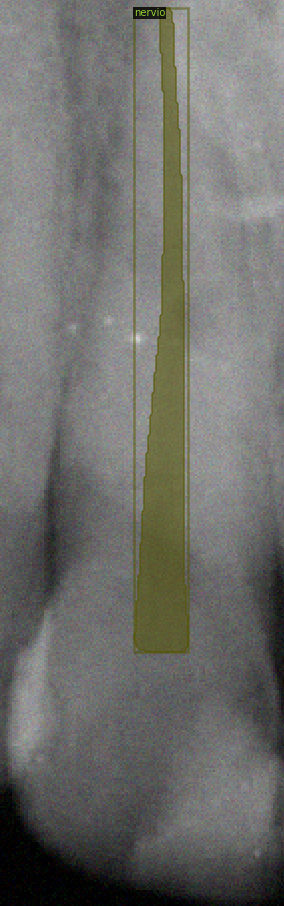

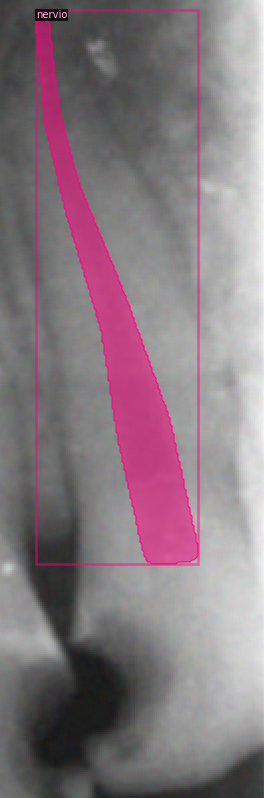

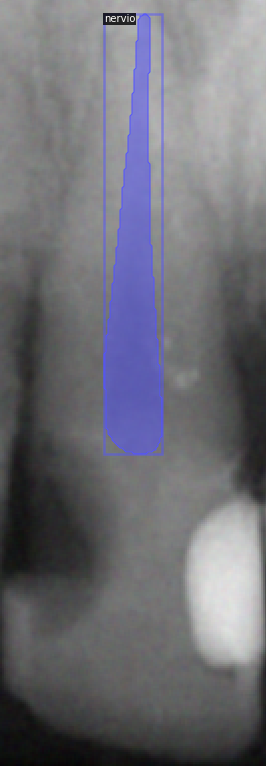

In [ ]:
nervios_metadata = MetadataCatalog.get("nervios_train")
dataset_train_ne = conversor_COCO("nervios_train/")

for d in random.sample(dataset_train_ne, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1],
                            scale=2,
                            metadata=nervios_metadata)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])


In [ ]:
cfg2 = get_cfg()
cfg2.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg2.DATASETS.TRAIN = ("nervios_train",)
cfg2.DATASETS.TEST = ()
cfg2.DATALOADER.NUM_WORKERS = 2
cfg2.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg2.SOLVER.IMS_PER_BATCH = 2
cfg2.SOLVER.BASE_LR = 0.00025
cfg2.SOLVER.MAX_ITER = 2000
cfg2.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg2.TEST.DTECTIONS_PER_IMAGE = 1


In [ ]:
os.makedirs(cfg2.OUTPUT_DIR, exist_ok=True)
trainer2 = DefaultTrainer(cfg2)
trainer2.resume_or_load(resume=False)
trainer2.train()


[04/21 20:12:42 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[04/21 20:12:42 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[04/21 20:13:12 d2.utils.events]:  eta: 0:48:26  iter: 19  total_loss: 1.357  loss_cls: 0.4965  loss_box_reg: 0.06827  loss_mask: 0.6887  loss_rpn_cls: 0.02166  loss_rpn_loc: 0.02344  time: 1.4581  data_time: 0.0178  lr: 4.9953e-06  max_mem: 3352M
[04/21 20:13:41 d2.utils.events]:  eta: 0:48:06  iter: 39  total_loss: 1.271  loss_cls: 0.4093  loss_box_reg: 0.07228  loss_mask: 0.6703  loss_rpn_cls: 0.01928  loss_rpn_loc: 0.02411  time: 1.4612  data_time: 0.0091  lr: 9.9902e-06  max_mem: 3441M
[04/21 20:14:10 d2.utils.events]:  eta: 0:47:26  iter: 59  total_loss: 1.12  loss_cls: 0.2745  loss_box_reg: 0.06617  loss_mask: 0.6387  loss_rpn_cls: 0.0175  loss_rpn_loc: 0.02207  time: 1.4525  data_time: 0.0079  lr: 1.4985e-05  max_mem: 3441M
[04/21 20:14:41 d2.utils.events]:  eta: 0:47:29  iter: 79  total_loss: 0.9706  loss_cls: 0.1753  loss_box_reg: 0.07009  loss_mask: 0.5965  loss_rpn_cls: 0.02008  loss_rpn_loc: 0.02086  time: 1.4772  data_time: 0.0147  lr: 1.998e-05  max_mem: 3441M
[04/21 20:

In [ ]:
cfg2.MODEL.WEIGHTS = os.path.join(cfg2.OUTPUT_DIR, "model_final.pth")
cfg2.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor2 = DefaultPredictor(cfg2)


/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


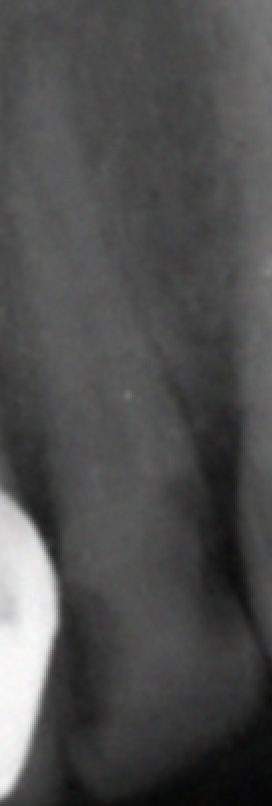

No se han encontrado ningún nervio


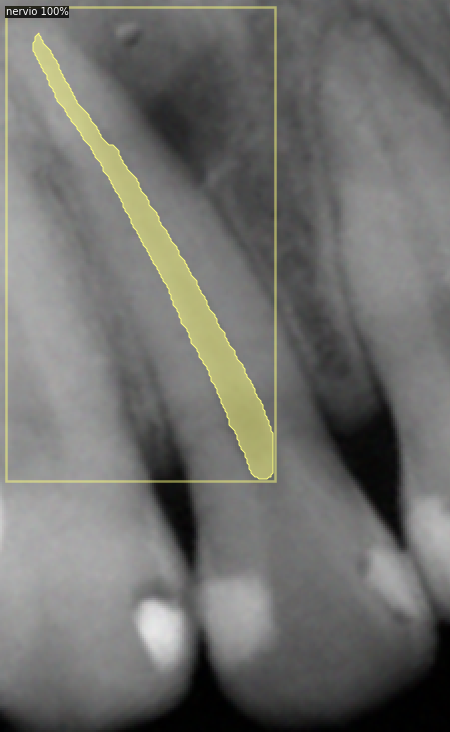

La precisión obtenida en el nervio es [[0.8654116]]


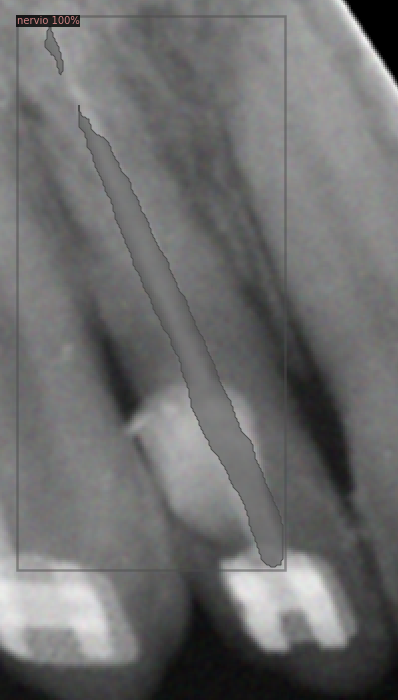

La precisión obtenida en el nervio es [[0.8903484]]


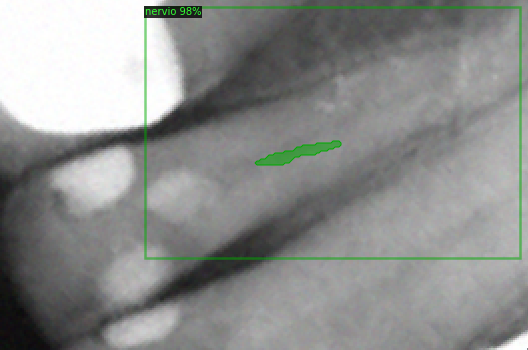

La precisión obtenida en el nervio es [[0.68764675]]


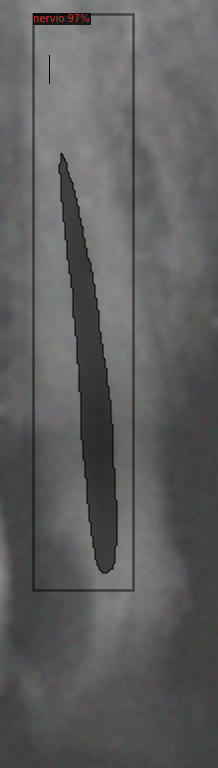

La precisión obtenida en el nervio es [[0.7705786]]


La precision media obtenida en los nervios es de: 0.8034963


In [ ]:
dataset_test_ne = conversor_COCO("nervios_test/")
iou_nervios = []

for d in dataset_test_ne:
    im = cv2.imread(d["file_name"])
    puntos=d["annotations"][0]["bbox"]

    outputs = predictor2(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=nervios_metadata,
                   scale=2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])
    
    #Calculo Intersection over Union (IoU)
    predicciones = outputs["instances"].pred_boxes #Obtenemos las predicciones  
    torch_array = torch.tensor([(puntos)]).to("cpu") #Creamos el array de torch con los puntos correctos del elemento  
    caja = Boxes(torch_array) #Creamos la caja de los puntos correctos

    if len(predicciones)==0:
      print("No se han encontrado ningún nervio")
    else:    
      iou = structures.pairwise_iou(predicciones[0].to("cpu"),caja)
      iou = iou.to("cpu").numpy()
      iou_nervios.append(iou)
      print("La precisión obtenida en el nervio es",iou)

iou_nervios = np.array(iou_nervios)
print("\n\nLa precision media obtenida en los nervios es de:", iou_nervios.mean())

## Validación

In [ ]:
cfg2.DATASETS.VAL = ("nervios_val",)
cfg2.SOLVER.MAX_ITER = 2000

os.makedirs(cfg2.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg2) 
val_loss = ValidationLoss(cfg2)  
trainer.register_hooks([val_loss])
# swap the order of PeriodicWriter and ValidationLoss
trainer._hooks = trainer._hooks[:-2] + trainer._hooks[-2:][::-1]
trainer.resume_or_load(resume=False)
trainer.train()

[04/17 21:22:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[04/17 21:22:44 d2.utils.events]:  eta: 0:50:55  iter: 19  total_loss: 0.09927  loss_cls: 0.01991  loss_box_reg: 0.02917  loss_mask: 0.04562  loss_rpn_cls: 5.025e-05  loss_rpn_loc: 0.00333  total_val_loss: 0.3549  val_loss_cls: 0.04579  val_loss_box_reg: 0.06905  val_loss_mask: 0.2528  val_loss_rpn_cls: 0.003921  val_loss_rpn_loc: 0.008103  time: 1.5148  data_time: 0.0250  lr: 4.9953e-06  max_mem: 3611M
[04/17 21:23:26 d2.utils.events]:  eta: 0:50:16  iter: 39  total_loss: 0.09516  loss_cls: 0.01955  loss_box_reg: 0.02681  loss_mask: 0.04415  loss_rpn_cls: 9.415e-05  loss_rpn_loc: 0.00323  total_val_loss: 0.41  val_loss_cls: 0.04684  val_loss_box_reg: 0.05669  val_loss_mask: 0.2854  val_loss_rpn_cls: 0.006596  val_loss_rpn_loc: 0.009297  time: 1.5096  data_time: 0.0106  lr: 9.9902e-06  max_mem: 3612M
[04/17 21:24:07 d2.utils.events]:  eta: 0:48:53  iter: 59  total_loss: 0.09078  loss_cls: 0.01803  loss_box_reg: 0.02534  loss_mask: 0.04508  loss_rpn_cls: 5.822e-05  loss_rpn_loc: 0.00288

In [ ]:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1755), started 2:03:42 ago. (Use '!kill 1755' to kill it.)

<IPython.core.display.Javascript object>